# Assignment 3

The assignment 3 contains 1 question and the due date is April 28th (Sunday) 23:59PM. If you have trouble in installing tensorflow in your computer, you may consider using Google Colab for this assignment.

## Question 1 How Yelp Uses Deep Learning to Classify Business Photos? (100 points)

Yelp hosts tens of millions of photos uploaded by Yelpers from all around the world. The wide variety of these photos provides a rich window into local businesses, a window we’re only just peeking through today.

One way we’re trying to open that window is by developing a photo understanding system which allows us to create semantic data about individual photographs. The data generated by the system has been powering our recent launch of tabbed photo browsing as well as our first attempts at content-based photo diversification.

You can check more details about Yelp's practices at [here](https://engineeringblog.yelp.com/2015/10/how-we-use-deep-learning-to-classify-business-photos-at-yelp.html)


![food](https://engineeringblog.yelp.com/images/posts/2015-10-14-photo-classification/image02.png)

In this question, you will be asked to building a Photo Classifier.

### Setup

In [ ]:
#!pip install ipywidgets

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from tensorflow import keras
import tensorflow as tf
from PIL import Image
import ipywidgets as widgets
keras.backend.clear_session()
tf.random.set_seed(42)
np.random.seed(42)
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

# Deine some parameters for the loader:
batch_size = 32
img_height = 256
img_width = 256

In [2]:
# Functions

def display_images(image_arrays, page=1, images_per_page=32, cols=4):
    """Display a paginated set of images."""
    start = (page - 1) * images_per_page
    end = start + images_per_page
    subset = image_arrays[start:end]

    n_images = len(subset)
    rows = (n_images + cols - 1) // cols
    plt.figure(figsize=(cols * 4, rows * 4))
    for i, image_array in enumerate(subset):
        plt.subplot(rows, cols, i + 1)
        plt.imshow(Image.fromarray(image_array))
        plt.title(f"index: {start + i}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

def interactive_image_viewer(category_images, images_per_page=32):
    total_images = len(category_images)
    max_pages = (total_images + images_per_page - 1) // images_per_page

    @widgets.interact(page=(1, max_pages))
    def display_page(page=1):
        display_images(category_images, page, images_per_page)

def show_few_pics(category, ids):
  width_per_image = 4
  total_width = width_per_image * len(ids)

  plt.figure(figsize=(total_width, width_per_image))
  for i, index in enumerate(ids):
      plt.subplot(1, len(ids), i + 1)
      plt.imshow(Image.fromarray(category_dict[category][index]))
      plt.title(f"index: {index}")
      plt.axis('off')
  plt.tight_layout()
  plt.show()

def performance_plot(hist):
    acc = hist.history['accuracy']
    val_acc = hist.history['val_accuracy']
    loss = hist.history['loss']
    val_loss = hist.history['val_loss']

    # Use the length of the loss array to determine the number of epochs
    epochs_range = range(len(loss))

    plt.figure(figsize=(8, 8))

    # Plot Training and Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.title('Training and Validation Accuracy')

    # Plot Training and Validation Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.title('Training and Validation Loss')

    plt.show()

Let's first upload the file images.npy and labels.npy and load the images dataset.

In [3]:
# mount google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Declaring paths
images_path = '/content/drive/My Drive/Machine Learning Part 2/IndivAssignment3/images.npy'
labels_path = '/content/drive/My Drive/Machine Learning Part 2/IndivAssignment3/labels.npy'

# Loading images and labels
images = np.load(images_path) # SHAPE: (1024, 256, 256, 3) -> (N_SAMPLES, HEIGHT, WIDTH, CHANNELS)
labels = np.load(labels_path) # SHAPE: (1024,) -> (N_SAMPLES,). Label encoded: 0, 1, 2, 3

print('Images shape:', images.shape)
print('Labels shape:', labels.shape)
print('Labels match the image at the respective 0 to 1024 position.')

Images shape: (1024, 256, 256, 3)
Labels shape: (1024,)
Labels match the image at the respective 0 to 1024 position.


There are four types of the images on Yelp: Food, Drink, Interior and Exterior

In [ ]:
np.unique(labels)

array([0, 1, 2, 3])

We visualize some random images from the dataset below:

1


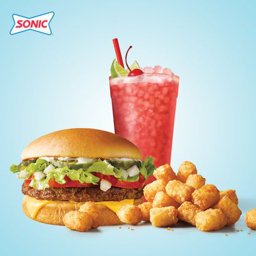

In [ ]:
# food: class 0
print(labels[5])
Image.fromarray(images[5])

0


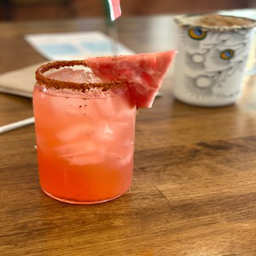

In [ ]:
# drink: class 1
print(labels[3])
Image.fromarray(images[3])

2


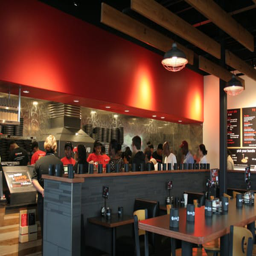

In [ ]:
# interior: class 2
print(labels[7])
Image.fromarray(images[7])

3


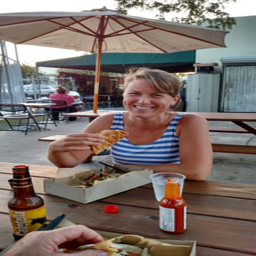

In [ ]:
# exterior: class 3
print(labels[8])
Image.fromarray(images[8])

Here, I already observe that the classes are not
- 0 -> Food,
- 1 -> Drink,
- 2 -> Interior, and
- 3 -> Exterior

but rather
- 0 -> Drink,
- 1 -> Food,
- 2 -> Interior, and
- 3 -> Exterior

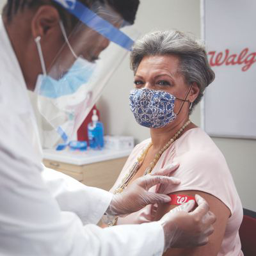

In [ ]:
# Deine some parameters for the loader:
batch_size = 32
img_height = 256
img_width = 256

# Loading images and labels
images = np.load(images_path) # SHAPE: (1024, 256, 256, 3) -> (N_SAMPLES, HEIGHT, WIDTH, CHANNELS)
labels = np.load(labels_path) # SHAPE: (1024,) -> (N_SAMPLES,). Label encoded: 0, 1, 2, 3

# Create a mapping for labels to category names
category_names = {0: 'Drink', 1: 'Food', 2: 'Interior', 3: 'Exterior'}
category_dict = {name: [] for name in category_names.values()}

# Populate the dictionary with images categorized by their labels
for img, label in zip(images, labels):
    category_dict[category_names[label]].append(img)

Image.fromarray(category_dict["Food"][12])

I noticed that there are misclassified pictures. Thus, before diving into the ML part, I first need to quickly clean the data. For that I simply kick out the clearly mislabeled images.

In [ ]:
# Food:
interactive_image_viewer(category_dict["Food"])

interactive(children=(IntSlider(value=1, description='page', max=8, min=1), Output()), _dom_classes=('widget-i…

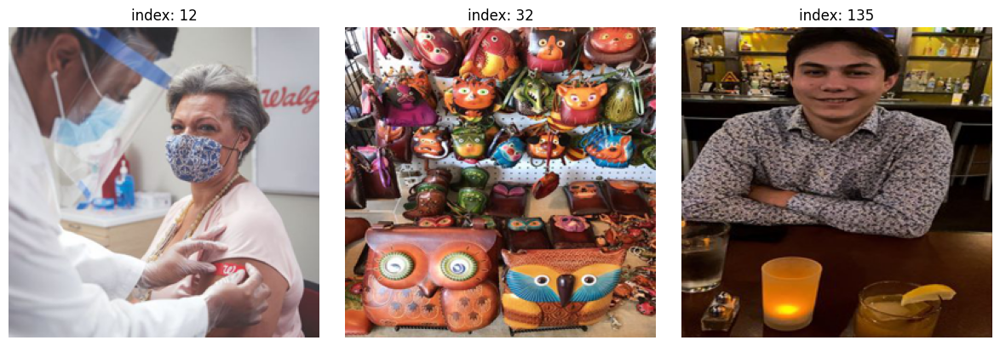

In [ ]:
misclassified_food_id = [12, 32, 135]
show_few_pics("Food", misclassified_food_id)

Those three pictures are clearly mislabeled. There are more that are also not of perfect quality, but as cleaning is not the focus of this assignment, I will only remove those that are clearly mislabeled, meaning those three pictures above. After that, I will do the same for the other three categories.

In [ ]:
# Remove misclassified images from the category "Food"
category_dict["Food"] = [img for idx, img in enumerate(category_dict["Food"]) if idx not in misclassified_food_id]


In [ ]:
# Drink:
interactive_image_viewer(category_dict["Drink"])

interactive(children=(IntSlider(value=1, description='page', max=8, min=1), Output()), _dom_classes=('widget-i…

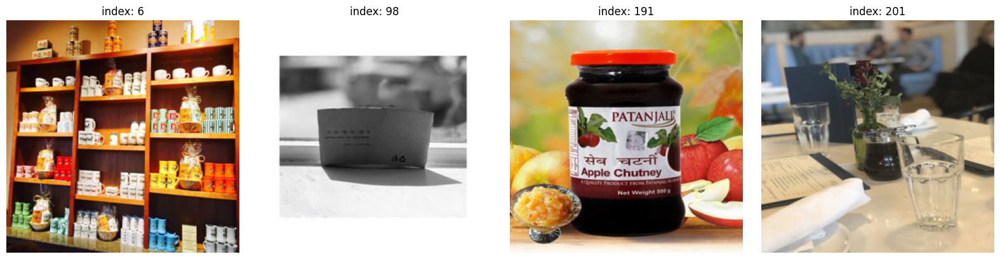

In [ ]:
misclassified_drink_id = [6, 98, 191, 201]
show_few_pics("Drink", misclassified_drink_id)

In [ ]:
# Remove misclassified images from the category "Drink"
category_dict["Drink"] = [img for idx, img in enumerate(category_dict["Drink"]) if idx not in misclassified_drink_id]

In [ ]:
# Interior:
interactive_image_viewer(category_dict["Interior"])

interactive(children=(IntSlider(value=1, description='page', max=8, min=1), Output()), _dom_classes=('widget-i…

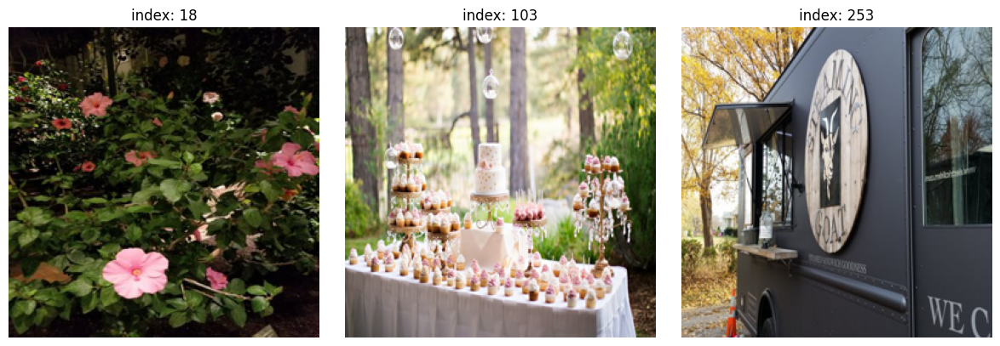

In [ ]:
misclassified_interior_id = [18, 103, 253]
show_few_pics("Interior", misclassified_interior_id)

In [ ]:
# Remove misclassified images from the category "Interior"
category_dict["Interior"] = [img for idx, img in enumerate(category_dict["Interior"]) if idx not in misclassified_interior_id]

In [ ]:
# Exterior:
interactive_image_viewer(category_dict["Exterior"])

interactive(children=(IntSlider(value=1, description='page', max=8, min=1), Output()), _dom_classes=('widget-i…

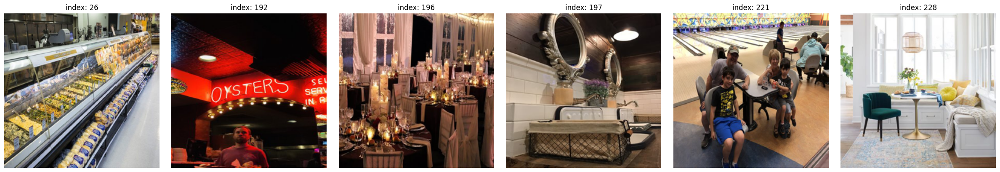

In [ ]:
misclassified_exterior_id = [26, 192, 196, 197, 221, 228]
show_few_pics("Exterior", misclassified_exterior_id)

In [ ]:
# Remove misclassified images from the category "Exterior"
category_dict["Exterior"] = [img for idx, img in enumerate(category_dict["Exterior"]) if idx not in misclassified_exterior_id]

Overall, I can say that the labeling in this dataset is not perfect, as there is a huge overlap in categories and no clear rule (at least for me) that says when to put it in which category. Thus, I would say that the human error for the classification task in this dataset would be higher than the claimed 5%. This is good to know, as I will from now on also adjust my expectations towards the neural network's performance.

Before completely starting with the neural network, I created a root directory with four subdirectories (one for each category) in my drive. I will thus, put the pictures in the respective directory.

In [4]:
# Define path to root directory
root_dir = '/content/drive/My Drive/Machine Learning Part 2/IndivAssignment3/Images-Root_dir'

In [ ]:
"""
This cell is meant to be run only once as it puts the images to the created
respective subfolders, i.e. Food, Drink, Interior, and Exterior.
"""

# # Create directories for each category
# for name in category_names.values():
#     os.makedirs(os.path.join(root_dir, name), exist_ok=True)

# # Save images to these directories
# for img, label in zip(images, labels):
#     category = category_names[label]
#     # Generate a unique filename for each image
#     filename = f"{np.random.randint(1e6)}.png"
#     filepath = os.path.join(root_dir, category, filename)
#     # Convert the image array to a PIL Image object and save it
#     Image.fromarray(img).save(filepath)


### Question 1.1 Training a deep neural network (15 points)

Practice training a deep neural network on the Yelp image dataset


Build a Deep Neural Network (DNN) with 20 hidden layers of 100 neurons each (that’s too many, but it’s the point of this question), using the RELU activation function.

Using Adam optimization, train the network on the dataset. Donot forget define your input and output layers.

Train the model for 100 epochs and use test set as the validation data during the training, explain how many parameters does the model have and whether the model will experience overfitting. You may consider plotting the losses and accuracy over epochs.

Now, that the setup is done, I can do a train-validation split.

In [9]:
# Defining the train dataset
train_ds = tf.keras.utils.image_dataset_from_directory(
  root_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

# Defining the validation dataset
val_ds = tf.keras.utils.image_dataset_from_directory(
  root_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 1008 files belonging to 4 classes.
Using 807 files for training.
Found 1008 files belonging to 4 classes.
Using 201 files for validation.


In [10]:
class_names = train_ds.class_names
num_classes = len(class_names)
print(class_names)

['Drink', 'Exterior', 'Food', 'Interior']


To optimize the loading of data and improve training speed, I configure the training dataset with caching and shuffling, and both datasets to prefetch data, allowing TensorFlow to automatically tune the buffer sizes for efficient data loading.

In [11]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

Now, I can implement the first model:

In [ ]:
# Baseline model

model1 = keras.models.Sequential([
    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.Dense(100, activation='relu'),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model1.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 196608)            0         
                                                                 
 dense (Dense)               (None, 100)               19660900  
                                                                 
 dense_1 (Dense)             (None, 100)               10100     
                                                                 
 dense_2 (Dense)             (None, 100)               10100     
                                                                 
 dense_3 (Dense)             (None, 100)               10100     
                                                                 
 dense_4 (Dense)             (None, 100)               10100     
                                                                 
 dense_5 (Dense)             (None, 100)               1

My model has a total of 19,853,204 parameters, which is quite large considering the architecture. The majority of these parameters come from the first dense layer following the flattening of the input, given the high dimensionality of the flattened data. With so many parameters, there is a substantial risk of overfitting, especially if my training dataset is not large enough to support the complexity of the model.

In [ ]:
epochs=100
history1 = model1.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/100
26/26 [==============================] - 14s 49ms/step - loss: 9.6671 - accuracy: 0.2379 - val_loss: 6.3880 - val_accuracy: 0.2488
Epoch 2/100
26/26 [==============================] - 1s 24ms/step - loss: 1.8962 - accuracy: 0.2553 - val_loss: 1.5159 - val_accuracy: 0.1990
Epoch 3/100
26/26 [==============================] - 1s 24ms/step - loss: 1.4228 - accuracy: 0.2887 - val_loss: 1.3550 - val_accuracy: 0.3383
Epoch 4/100
26/26 [==============================] - 1s 24ms/step - loss: 1.3130 - accuracy: 0.3494 - val_loss: 1.3820 - val_accuracy: 0.2786
Epoch 5/100
26/26 [==============================] - 1s 25ms/step - loss: 1.2893 - accuracy: 0.3395 - val_loss: 1.3302 - val_accuracy: 0.3333
Epoch 6/100
26/26 [==============================] - 1s 24ms/step - loss: 1.2398 - accuracy: 0.3990 - val_loss: 1.3054 - val_accuracy: 0.3831
Epoch 7/100
26/26 [==============================] - 1s 24ms/step - loss: 1.1888 - accuracy: 0.4374 - val_loss: 1.1935 - val_accuracy: 0.4229
Epoch

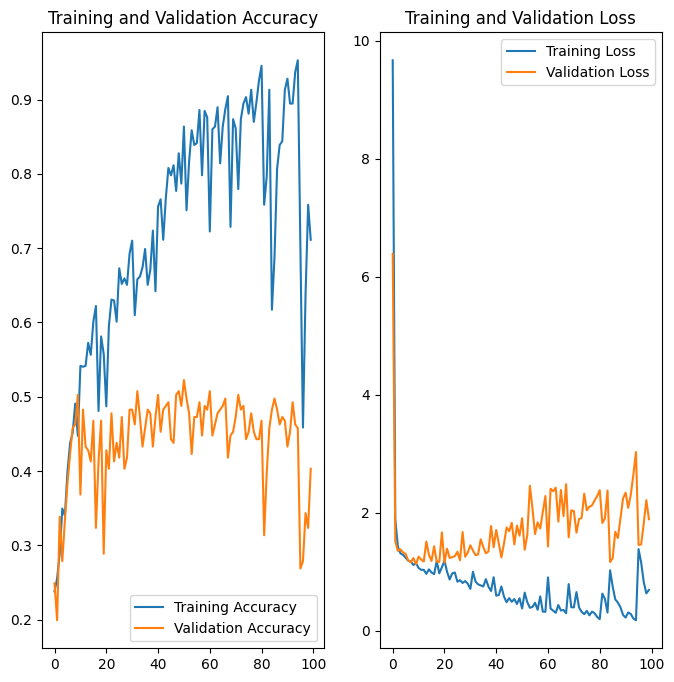

In [ ]:
performance_plot(history1)

Overall, I can observe that the neural network is experiencing overfitting as evidenced by the training accuracy increasing and reaching high levels, while the validation accuracy remains significantly lower and does not improve. In the loss graphs, the training loss decreases substantially, yet the validation loss does not show a similar decline and even increases, which further indicates that the model is not generalizing well to new, unseen data. I'll need to consider implementing strategies to combat overfitting (next task).

Final validation accuracy: 0.4030

### Question 1.2 (25 points)

Try reduce the overfitting and improve the model performance. You can try the bag of tricks to the model from the class. This may include one or more techniques such as **weight regularization**, **batch normalization**, **dropout**, **Early stopping**, etc. You should perform ``ablation study``, a common techniqued used in machine learning community to show the effectivess of the introduced technique. In other words, show your step-by-step improvement by including these techniques and repeat the repeat the previous training process. Explain whether and how these techniques help achieve a better result. You may consider stopping improving the model by making it at least 10% better than the previous model architecture.

In [12]:
# L2 weight regularization

model2_1 = keras.models.Sequential([
    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.Dense(100, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model2_1.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

model2_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_1 (Flatten)         (None, 196608)            0         
                                                                 
 dense_20 (Dense)            (None, 100)               19660900  
                                                                 
 dense_21 (Dense)            (None, 100)               10100     
                                                                 
 dense_22 (Dense)            (None, 100)               10100     
                                                                 
 dense_23 (Dense)            (None, 100)               10100     
                                                                 
 dense_24 (Dense)            (None, 100)               10100     
                                                                 
 dense_25 (Dense)            (None, 100)               1

Epoch 1/100
26/26 [==============================] - 68s 493ms/step - loss: 12.4523 - accuracy: 0.2330 - val_loss: 4.6394 - val_accuracy: 0.2537
Epoch 2/100
26/26 [==============================] - 1s 23ms/step - loss: 3.8597 - accuracy: 0.2677 - val_loss: 3.2830 - val_accuracy: 0.2488
Epoch 3/100
26/26 [==============================] - 1s 22ms/step - loss: 3.1769 - accuracy: 0.2924 - val_loss: 3.0474 - val_accuracy: 0.2139
Epoch 4/100
26/26 [==============================] - 1s 22ms/step - loss: 2.9594 - accuracy: 0.2602 - val_loss: 2.9189 - val_accuracy: 0.1841
Epoch 5/100
26/26 [==============================] - 1s 22ms/step - loss: 2.8099 - accuracy: 0.3048 - val_loss: 2.8011 - val_accuracy: 0.2239
Epoch 6/100
26/26 [==============================] - 1s 22ms/step - loss: 2.6747 - accuracy: 0.3259 - val_loss: 2.5666 - val_accuracy: 0.3731
Epoch 7/100
26/26 [==============================] - 1s 22ms/step - loss: 2.5602 - accuracy: 0.3680 - val_loss: 2.5317 - val_accuracy: 0.3980
Epo

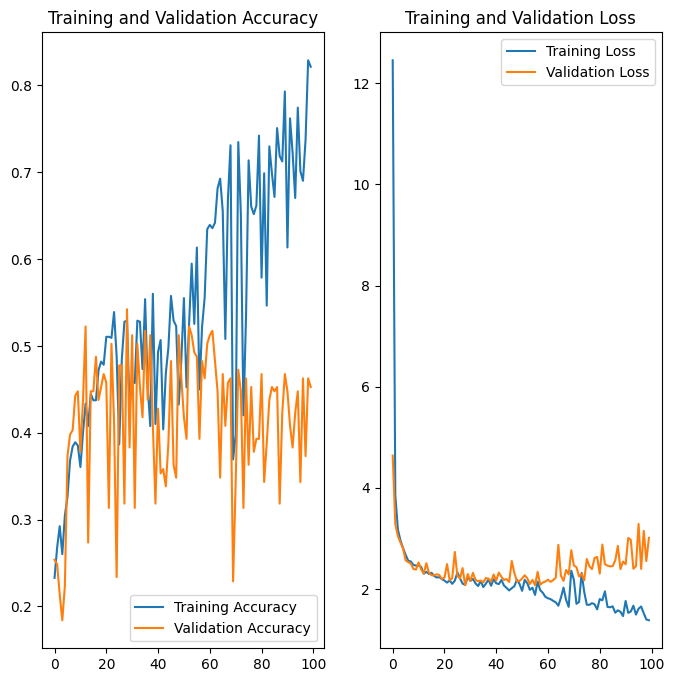

In [13]:
# Training
epochs=100
history2_1 = model2_1.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(history2_1)

The implementation of L2 regularization in my model has led to a final validation accuracy of 0.4527, which is almost already 5% higher than the baseline's final validation accuracy of 0.4030. This alone is not too much of an improvement, but it also helped against overfitting, as the size of the gap decreased.

Final validation accuracy: 0.4527

In [15]:
# Dropout layer

model2_2 = keras.models.Sequential([
    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # Dropout layer
    keras.layers.Dropout(0.5),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.Dense(100, activation='relu'),
        keras.layers.Dropout(0.5),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model2_2.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

Epoch 1/100
26/26 [==============================] - 7s 32ms/step - loss: 3978.4771 - accuracy: 0.2429 - val_loss: 1.4269 - val_accuracy: 0.1891
Epoch 2/100
26/26 [==============================] - 1s 22ms/step - loss: 119.3999 - accuracy: 0.2540 - val_loss: 1.3860 - val_accuracy: 0.2537
Epoch 3/100
26/26 [==============================] - 1s 22ms/step - loss: 1.5811 - accuracy: 0.2280 - val_loss: 1.3864 - val_accuracy: 0.2537
Epoch 4/100
26/26 [==============================] - 1s 22ms/step - loss: 1.4092 - accuracy: 0.2528 - val_loss: 1.3874 - val_accuracy: 0.1841
Epoch 5/100
26/26 [==============================] - 1s 22ms/step - loss: 1.3949 - accuracy: 0.2751 - val_loss: 1.3877 - val_accuracy: 0.1841
Epoch 6/100
26/26 [==============================] - 1s 22ms/step - loss: 1.3900 - accuracy: 0.2577 - val_loss: 1.3890 - val_accuracy: 0.1841
Epoch 7/100
26/26 [==============================] - 1s 22ms/step - loss: 1.3857 - accuracy: 0.2652 - val_loss: 1.3893 - val_accuracy: 0.1841
E

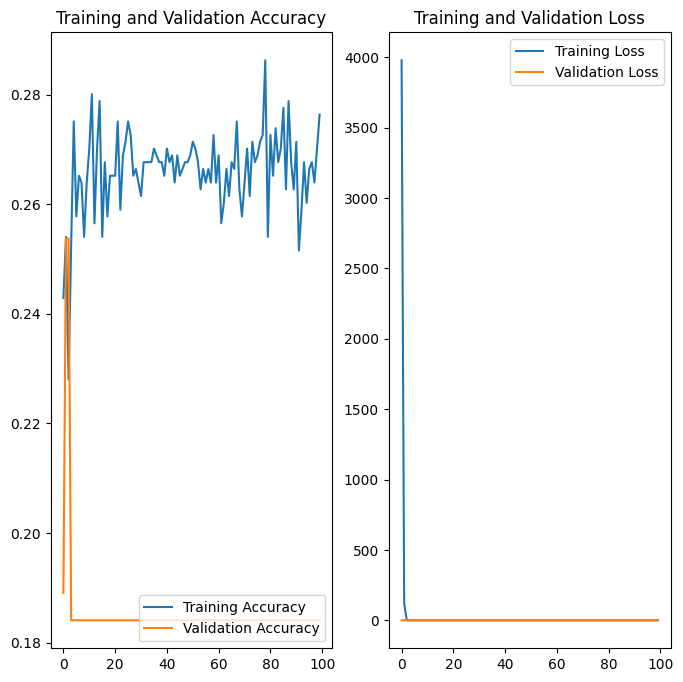

In [16]:
# Training
epochs=100
history2_2 = model2_2.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(history2_2)

Applying a dropout rate of 0.5 in combination with my baseline model resulted in a final validation accuracy of 0.1841, which is significantely lower than the baseline's validation accuracy. While dropout is a common technique to prevent overfitting, those plots indicate that the dropout rate might be a bit too high, such that the model could not learn as it should. Further, I will also reduce the number of dropout layers to only one after the input layer, because adding dropout to every layer may be excessive for the network architecture being used. Reducing the number of dropout layers and adjusting the dropout rate should help strike a better balance between preventing overfitting and allowing the model to learn effectively from the training data.

Final validation accuracy: 0.1841

In [19]:
# Dropout layers (only 20% dropout rate and only one dropout layer)

model2_3 = keras.models.Sequential([
    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # Dropout layer
    keras.layers.Dropout(0.2),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.Dense(100, activation='relu'),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model2_3.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

Epoch 1/100
26/26 [==============================] - 5s 30ms/step - loss: 9.6819 - accuracy: 0.2788 - val_loss: 5.1724 - val_accuracy: 0.2488
Epoch 2/100
26/26 [==============================] - 1s 21ms/step - loss: 2.5200 - accuracy: 0.2454 - val_loss: 2.0999 - val_accuracy: 0.1841
Epoch 3/100
26/26 [==============================] - 1s 21ms/step - loss: 1.5090 - accuracy: 0.2701 - val_loss: 1.5860 - val_accuracy: 0.3035
Epoch 4/100
26/26 [==============================] - 1s 22ms/step - loss: 1.3916 - accuracy: 0.3098 - val_loss: 1.3760 - val_accuracy: 0.2935
Epoch 5/100
26/26 [==============================] - 1s 22ms/step - loss: 1.3833 - accuracy: 0.3086 - val_loss: 1.3084 - val_accuracy: 0.3483
Epoch 6/100
26/26 [==============================] - 1s 21ms/step - loss: 1.3208 - accuracy: 0.3817 - val_loss: 1.3997 - val_accuracy: 0.3731
Epoch 7/100
26/26 [==============================] - 1s 21ms/step - loss: 1.2426 - accuracy: 0.4015 - val_loss: 1.2249 - val_accuracy: 0.4030
Epoch 

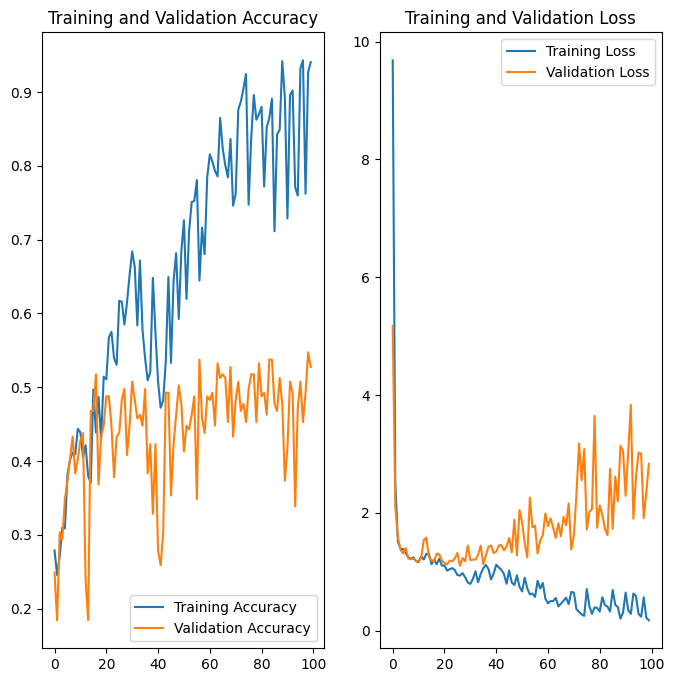

In [20]:
# Training
epochs=100
history2_3 = model2_3.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(history2_3)

With the adjusted dropout rate of 0.2, the final validation accuracy of my model increases to 0.5274, which is more than 12% higher than the one of the basline model. However, the problem of overfitting is still quite present, as the training accuracy is very high (0.9405)

Final validation accuracy: 0.5274

Note: I could stop here, as I already reached the 10% improvement. Yet, I want to see, whether I can achive this performance, but with a smaller gap between train and validation, i.e. reducing overfitting.

In [21]:
# Batch normalization

model2_4 = keras.models.Sequential([
    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.BatchNormalization(),
        keras.layers.Dense(100, activation='relu'),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model2_4.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

Epoch 1/100
26/26 [==============================] - 13s 52ms/step - loss: 1.5862 - accuracy: 0.2751 - val_loss: 1.3967 - val_accuracy: 0.2189
Epoch 2/100
26/26 [==============================] - 1s 33ms/step - loss: 1.4740 - accuracy: 0.2763 - val_loss: 1.3869 - val_accuracy: 0.2886
Epoch 3/100
26/26 [==============================] - 1s 33ms/step - loss: 1.4783 - accuracy: 0.2602 - val_loss: 1.3862 - val_accuracy: 0.2687
Epoch 4/100
26/26 [==============================] - 1s 33ms/step - loss: 1.4515 - accuracy: 0.2677 - val_loss: 1.3822 - val_accuracy: 0.2836
Epoch 5/100
26/26 [==============================] - 1s 32ms/step - loss: 1.4142 - accuracy: 0.2974 - val_loss: 1.3812 - val_accuracy: 0.2637
Epoch 6/100
26/26 [==============================] - 1s 32ms/step - loss: 1.4117 - accuracy: 0.3073 - val_loss: 1.3580 - val_accuracy: 0.3184
Epoch 7/100
26/26 [==============================] - 1s 34ms/step - loss: 1.3608 - accuracy: 0.3445 - val_loss: 1.3956 - val_accuracy: 0.3134
Epoch

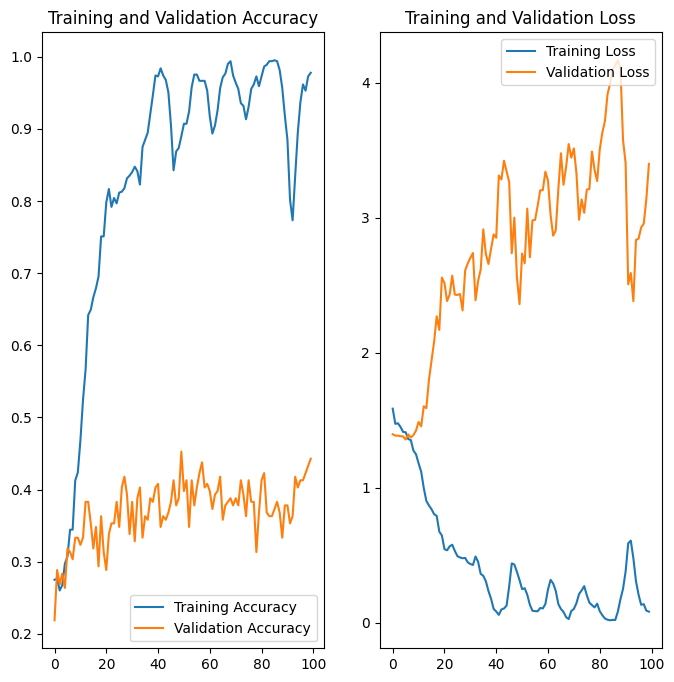

In [22]:
# Training
epochs=100
history2_4 = model2_4.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(history2_4)

The training accuracy plot shows the model reaching high accuracy on the training data, but there's again a notable gap between training and validation accuracy. The validation accuracy remains significantly lower than the training accuracy throughout the training process, which indicates that while batch normalization has improved the stability of the training, the model is still overfitting and the gap between the training and validation metrics is substantial.

Final validation accuracy: 0.4428

Epoch 1/100
26/26 [==============================] - 13s 55ms/step - loss: 4.0216 - accuracy: 0.2813 - val_loss: 4.1159 - val_accuracy: 0.2836
Epoch 2/100
26/26 [==============================] - 1s 34ms/step - loss: 4.3213 - accuracy: 0.2392 - val_loss: 4.2171 - val_accuracy: 0.3234
Epoch 3/100
26/26 [==============================] - 1s 34ms/step - loss: 4.2688 - accuracy: 0.3259 - val_loss: 4.2446 - val_accuracy: 0.3134
Epoch 4/100
26/26 [==============================] - 1s 33ms/step - loss: 4.2979 - accuracy: 0.2986 - val_loss: 4.2525 - val_accuracy: 0.3483
Epoch 5/100
26/26 [==============================] - 1s 33ms/step - loss: 4.2942 - accuracy: 0.3061 - val_loss: 4.2371 - val_accuracy: 0.3632
Epoch 6/100
26/26 [==============================] - 1s 33ms/step - loss: 4.2586 - accuracy: 0.3024 - val_loss: 4.2227 - val_accuracy: 0.3333
Epoch 7/100
26/26 [==============================] - 1s 33ms/step - loss: 4.2031 - accuracy: 0.3817 - val_loss: 4.2130 - val_accuracy: 0.3781
Epoch

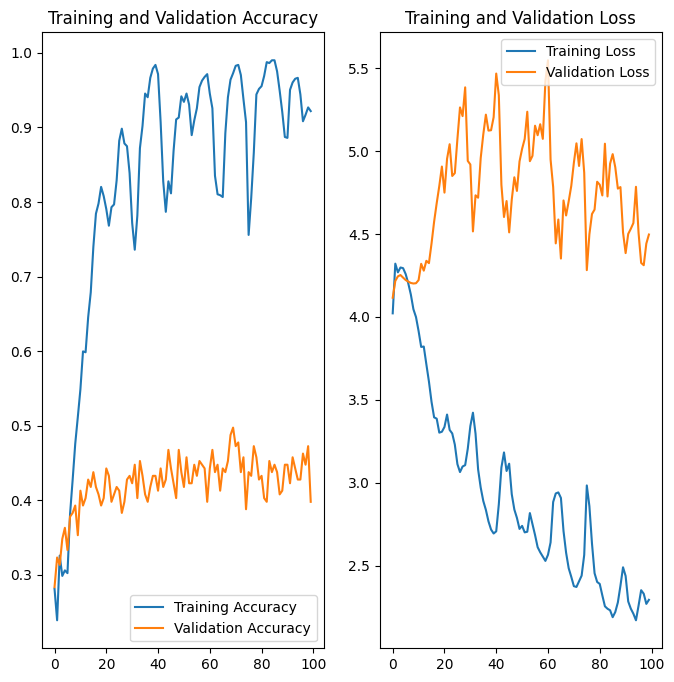

In [23]:
# L2 weight regularization & Batch normalization

model2_5 = keras.models.Sequential([
    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.BatchNormalization(),
        keras.layers.Dense(100, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])


# Compile the model
model2_5.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
history2_5 = model2_5.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(history2_5)

Combining L2 regularization with batch normalization in my baseline model has resulted in a slight deterioration, with a final validation accuracy of 0.3980, just below the baseline's 0.4030. Despite this, there's still a significant gap between the training accuracy, which is nearly perfect, and the validation accuracy. This discrepancy suggests that while the model performs exceedingly well on the training data, it struggles to generalize these results to the validation set, indicating that overfitting is still present.

Final validation accuracy: 0.3980

Epoch 1/100
26/26 [==============================] - 6s 33ms/step - loss: 6.6856 - accuracy: 0.2392 - val_loss: 3.7979 - val_accuracy: 0.2388
Epoch 2/100
26/26 [==============================] - 1s 22ms/step - loss: 3.9448 - accuracy: 0.2354 - val_loss: 3.3419 - val_accuracy: 0.1841
Epoch 3/100
26/26 [==============================] - 1s 22ms/step - loss: 3.1672 - accuracy: 0.2553 - val_loss: 3.0299 - val_accuracy: 0.2488
Epoch 4/100
26/26 [==============================] - 1s 23ms/step - loss: 2.8994 - accuracy: 0.3408 - val_loss: 2.7856 - val_accuracy: 0.3632
Epoch 5/100
26/26 [==============================] - 1s 22ms/step - loss: 2.7687 - accuracy: 0.3556 - val_loss: 2.6877 - val_accuracy: 0.3234
Epoch 6/100
26/26 [==============================] - 1s 22ms/step - loss: 2.5857 - accuracy: 0.4002 - val_loss: 2.5274 - val_accuracy: 0.4378
Epoch 7/100
26/26 [==============================] - 1s 22ms/step - loss: 2.4904 - accuracy: 0.4164 - val_loss: 2.6916 - val_accuracy: 0.3582
Epoch 

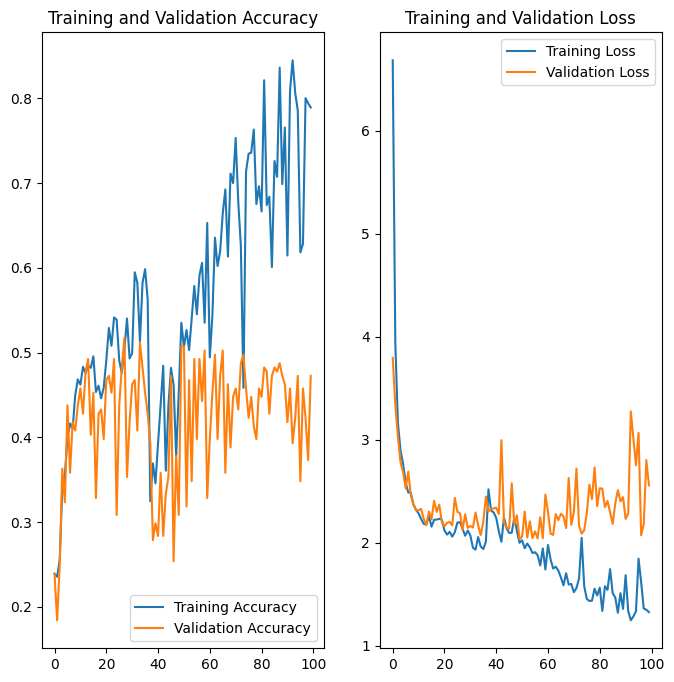

In [24]:
# L2 weight regularization & Dropout

model2_6 = keras.models.Sequential([
    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # Dropout layer
    keras.layers.Dropout(0.2),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.Dense(100, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model2_6.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
history2_6 = model2_6.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(history2_6)

Incorporating both L2 regularization and a dropout rate of 0.2 into my baseline model has led to a final validation accuracy of 0.4726, which outperfomes the baseline model by almost 7%. However, overfitting is still super present.

Final validation accuracy: 0.4726

Epoch 1/100
26/26 [==============================] - 13s 51ms/step - loss: 1.5586 - accuracy: 0.2553 - val_loss: 1.3921 - val_accuracy: 0.2189
Epoch 2/100
26/26 [==============================] - 1s 33ms/step - loss: 1.4875 - accuracy: 0.2900 - val_loss: 1.3904 - val_accuracy: 0.2488
Epoch 3/100
26/26 [==============================] - 1s 33ms/step - loss: 1.4355 - accuracy: 0.2986 - val_loss: 1.3929 - val_accuracy: 0.2438
Epoch 4/100
26/26 [==============================] - 1s 32ms/step - loss: 1.3839 - accuracy: 0.3309 - val_loss: 1.4034 - val_accuracy: 0.2438
Epoch 5/100
26/26 [==============================] - 1s 32ms/step - loss: 1.3975 - accuracy: 0.3259 - val_loss: 1.4157 - val_accuracy: 0.2040
Epoch 6/100
26/26 [==============================] - 1s 31ms/step - loss: 1.3113 - accuracy: 0.3817 - val_loss: 1.4076 - val_accuracy: 0.2438
Epoch 7/100
26/26 [==============================] - 1s 32ms/step - loss: 1.2682 - accuracy: 0.4325 - val_loss: 1.4231 - val_accuracy: 0.2338
Epoch

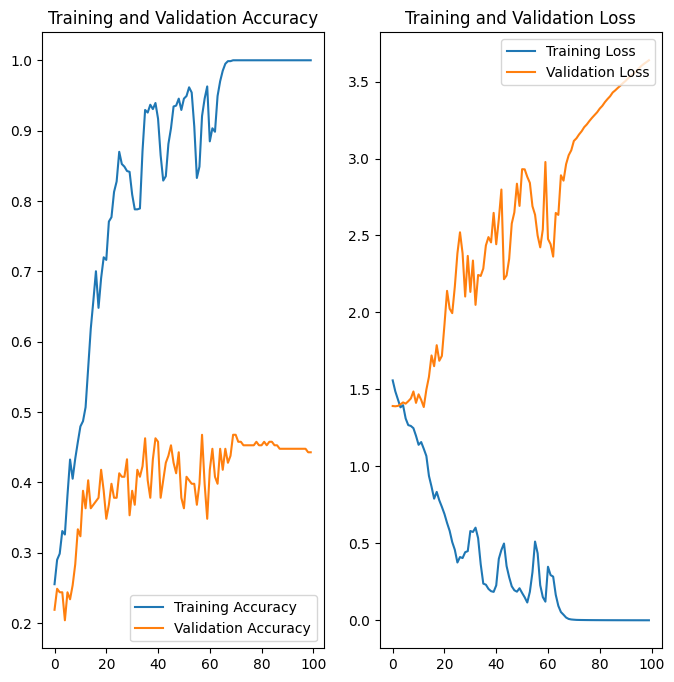

In [25]:
# Batch normalization & Dropout

model2_7 = keras.models.Sequential([
    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # Dropout layer
    keras.layers.Dropout(0.2),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.BatchNormalization(),
        keras.layers.Dense(100, activation='relu'),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model2_7.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
history2_7 = model2_7.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(history2_7)

Incorporating both L2 regularization and a dropout rate of 0.2 into my baseline model has led to a final validation accuracy of 0.4428, which is 4% higher than the performance of the baseline model. However, looking at those graphs, overfitting is still super present. Worth mentioning, however, is the training accuracy of 100%.

Final validation accuracy: 0.4428

Epoch 1/100
26/26 [==============================] - 13s 56ms/step - loss: 4.0672 - accuracy: 0.2528 - val_loss: 4.1500 - val_accuracy: 0.1990
Epoch 2/100
26/26 [==============================] - 1s 36ms/step - loss: 4.3268 - accuracy: 0.2701 - val_loss: 4.2880 - val_accuracy: 0.2338
Epoch 3/100
26/26 [==============================] - 1s 33ms/step - loss: 4.3495 - accuracy: 0.3011 - val_loss: 4.3237 - val_accuracy: 0.2836
Epoch 4/100
26/26 [==============================] - 1s 33ms/step - loss: 4.3633 - accuracy: 0.2949 - val_loss: 4.3164 - val_accuracy: 0.3134
Epoch 5/100
26/26 [==============================] - 1s 33ms/step - loss: 4.3313 - accuracy: 0.3160 - val_loss: 4.3220 - val_accuracy: 0.3483
Epoch 6/100
26/26 [==============================] - 1s 33ms/step - loss: 4.3196 - accuracy: 0.3383 - val_loss: 4.3438 - val_accuracy: 0.3284
Epoch 7/100
26/26 [==============================] - 1s 33ms/step - loss: 4.3541 - accuracy: 0.3036 - val_loss: 4.3457 - val_accuracy: 0.2289
Epoch

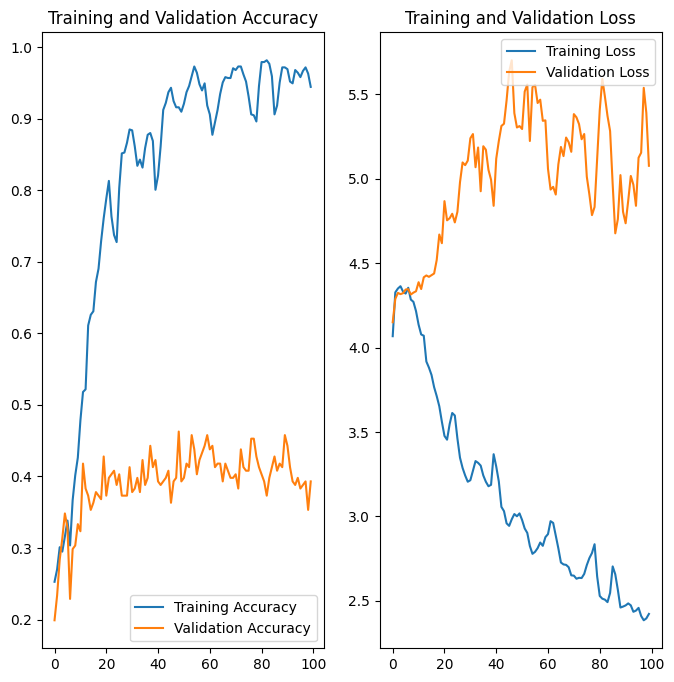

In [26]:
# L2 weight regularization & Batch normalization & Dropout

model2_8 = keras.models.Sequential([
    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # Dropout layer
    keras.layers.Dropout(0.2),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.BatchNormalization(),
        keras.layers.Dense(100, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model2_8.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
history2_8 = model2_8.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(history2_8)

Incorporating all of the above, i.e. L2 regularization, a dropout rate of 0.2, and batch normalization into my baseline model has led to a final validation accuracy of 0.3930, which is lower than the baseline model's performance. Further, looking at those graphs, overfitting is still super present.

Final validation accuracy: 0.3930

Until now, I attempted different strategies so far on the baseline model:
1. **L2 Regularization Alone**: Improved validation accuracy to 0.4527, slightly reducing overfitting.
2. **High Dropout Rate (0.5) Alone**: Resulted in a significantly lower validation accuracy of 0.1841, suggesting over-regulation and hindered learning.
3. **Adjusted Dropout Rate (0.2) Alone**: This adjustment brought the validation accuracy up to 0.5274, a notable improvement over the baseline, although a high training accuracy of 0.9405 indicated persistent overfitting.
4. **Batch Normalization Alone**: Led to a validation accuracy of 0.4428, improving stability but still leaving a gap between training and validation accuracies.
5. **L2 Regularization with Batch Normalization**: Slightly reduced validation accuracy to 0.3980, with continued overfitting.
6. **L2 Regularization with a Dropout Rate of 0.2**: Increased validation accuracy to 0.4726, showing some improvement but not fully resolving overfitting.
7. **Combination of L2 Regularization, 0.2 Dropout, and Batch Normalization**: This comprehensive approach resulted in a validation accuracy of 0.3930, which was lower than the baseline performance.

Among these trials, the incorporation of a single dropout layer with a 0.2 rate directly into the baseline model proved the most effective, increasing the validation accuracy to 0.5274, which is more than 12% higher than that of the baseline model. This setup, however, still exhibits a significant overfitting issue as indicated by the large gap between training and validation accuracies.

Given the success of the dropout adjustment, the next step involves integrating data augmentation into this configuration. Data augmentation will potentially enhance the model's ability to generalize by artificially expanding the training dataset with modified versions of existing data.

Epoch 1/100
26/26 [==============================] - 9s 45ms/step - loss: 6.6436 - accuracy: 0.2404 - val_loss: 1.5514 - val_accuracy: 0.2338
Epoch 2/100
26/26 [==============================] - 1s 27ms/step - loss: 1.5736 - accuracy: 0.2664 - val_loss: 1.6216 - val_accuracy: 0.1841
Epoch 3/100
26/26 [==============================] - 1s 27ms/step - loss: 1.4307 - accuracy: 0.2689 - val_loss: 1.3799 - val_accuracy: 0.2886
Epoch 4/100
26/26 [==============================] - 1s 27ms/step - loss: 1.3663 - accuracy: 0.2999 - val_loss: 1.3895 - val_accuracy: 0.1841
Epoch 5/100
26/26 [==============================] - 1s 27ms/step - loss: 1.3557 - accuracy: 0.3185 - val_loss: 1.2756 - val_accuracy: 0.4080
Epoch 6/100
26/26 [==============================] - 1s 27ms/step - loss: 1.3236 - accuracy: 0.3507 - val_loss: 1.3379 - val_accuracy: 0.3085
Epoch 7/100
26/26 [==============================] - 1s 27ms/step - loss: 1.3174 - accuracy: 0.3680 - val_loss: 1.2893 - val_accuracy: 0.3184
Epoch 

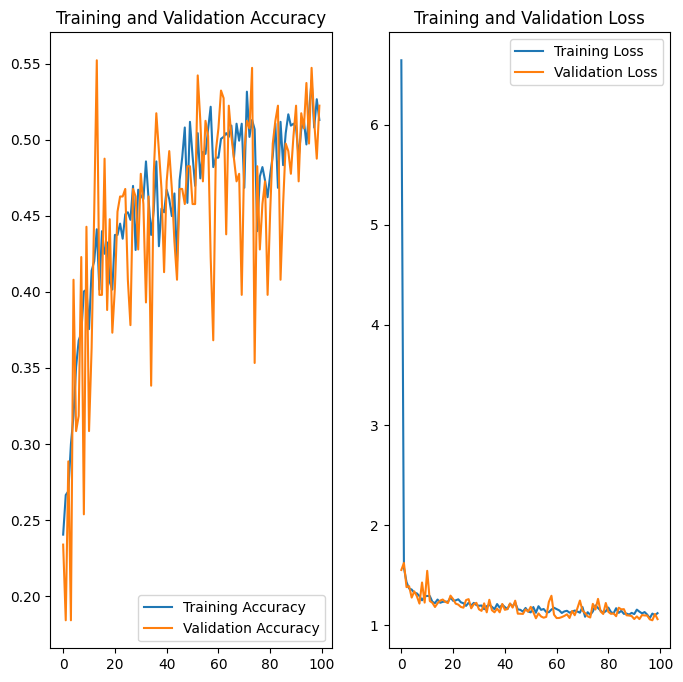

In [27]:
# Data augmentation and best model

# model
model2_9 = keras.models.Sequential([
    # Data augmentation
    keras.Sequential([
      keras.layers.RandomFlip('horizontal'),
      keras.layers.RandomRotation(0.2),
      keras.layers.RandomZoom(0.2),
      keras.layers.RandomContrast(0.2),
      keras.layers.RandomBrightness(0.2),
      keras.layers.RandomTranslation(height_factor=0.1, width_factor=0.1),
      keras.layers.RandomCrop(height=img_height-20, width=img_width-20),
      keras.layers.GaussianNoise(0,1)
    ]),

    # Input layer
    keras.layers.Flatten(input_shape=[img_height, img_width, 3]),

    # Dropout layer
    keras.layers.Dropout(0.2),

    # 20 hidden layers
    *[layer for i in range(20) for layer in (
        keras.layers.Dense(100, activation='relu'),
    )],

    # Output layer
    keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model2_9.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
model2_9 = model2_9.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(model2_9)

Here, I can see that overfitting is not a problem anymore. Further, I reached the goal of improving the model by 10% as the validation accuracy is 0.5224, 12% more than the baseline.

Overall, this is still not a good performance. For that the neural network is way to big (too many layers) and I did not do any hyperparameter optimization, which would most likely also lead to an increase in performance. Hyperparameter optimization would include adjusting learning rates, tuning the optimizer settings, experimenting with different architectures by altering the number of layers and the number of neurons per layer, and possibly varying the activation functions. I, however, stop here with my ablation study, as both, the performance, and the generalization (no overfitting) improved sufficiently.

Final validation accuracy: 0.5224

### Question 1.3 Convolutional Neural Network (25 points)

Now, let's define the Convolutional Neural Network.

❓ **Question** ❓ Define a CNN that is composed of:
- a Conv2D layer with 32 filters, a kernel size of (3, 3), the relu activation function, and a padding equal to `same`
- a MaxPooling2D layer with a pool size of (2, 2)
- a Conv2D layer with 64 filters, a kernel size of (3, 3), the relu activation function, and a padding equal to `same`
- a MaxPooling2D layer with a pool size of (2, 2)
- a Conv2D layer with 128 filters, a kernel size of (3, 3), the relu activation function, and a padding equal to `same`
- a MaxPooling2D layer with a pool size of (3, 3)
- a Flatten layer
- a dense function with 120 neurons with the `relu` activation function
- a dense function with 60 neurons with the `relu` activation function
- a dropout layer (with a rate of 0.5), to regularize the network
- a dense function related to your task

Estimate the model and report your test accuracy. Is it better than the multi-layer perceptron.

In [28]:
from functools import partial

DefaultConv2D = partial(keras.layers.Conv2D,
                        kernel_size=(3, 3),
                        activation='relu',
                        padding="SAME")

model3 = keras.models.Sequential([
    DefaultConv2D(filters=32, input_shape=[img_height, img_width, 3]),
    keras.layers.MaxPooling2D(pool_size=(2,2)),
    DefaultConv2D(filters=64),
    keras.layers.MaxPooling2D(pool_size=(2,2)),
    DefaultConv2D(filters=128),
    keras.layers.MaxPooling2D(pool_size=(3,3)),
    keras.layers.Flatten(),
    keras.layers.Dense(units=120, activation='relu'),
    keras.layers.Dense(units=60, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(units=4, activation='softmax'),
])

In [29]:
model3.compile(optimizer='adam',
              loss="sparse_categorical_crossentropy",
              metrics=['accuracy'])

In [30]:
model3.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 256, 256, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 128, 128, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 64, 64, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 21, 21, 128)     

In [31]:
epochs=100
history3 = model3.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/100
26/26 [==============================] - 9s 130ms/step - loss: 58.4125 - accuracy: 0.2664 - val_loss: 1.4782 - val_accuracy: 0.2139
Epoch 2/100
26/26 [==============================] - 2s 60ms/step - loss: 1.3684 - accuracy: 0.3185 - val_loss: 1.3630 - val_accuracy: 0.3234
Epoch 3/100
26/26 [==============================] - 2s 62ms/step - loss: 1.2411 - accuracy: 0.4585 - val_loss: 1.3575 - val_accuracy: 0.3881
Epoch 4/100
26/26 [==============================] - 2s 61ms/step - loss: 1.0478 - accuracy: 0.5836 - val_loss: 1.3871 - val_accuracy: 0.3383
Epoch 5/100
26/26 [==============================] - 2s 60ms/step - loss: 0.8632 - accuracy: 0.6506 - val_loss: 1.7620 - val_accuracy: 0.3483
Epoch 6/100
26/26 [==============================] - 2s 61ms/step - loss: 0.7000 - accuracy: 0.7212 - val_loss: 1.7921 - val_accuracy: 0.3632
Epoch 7/100
26/26 [==============================] - 2s 61ms/step - loss: 0.5931 - accuracy: 0.7732 - val_loss: 1.9408 - val_accuracy: 0.3781
Epoc

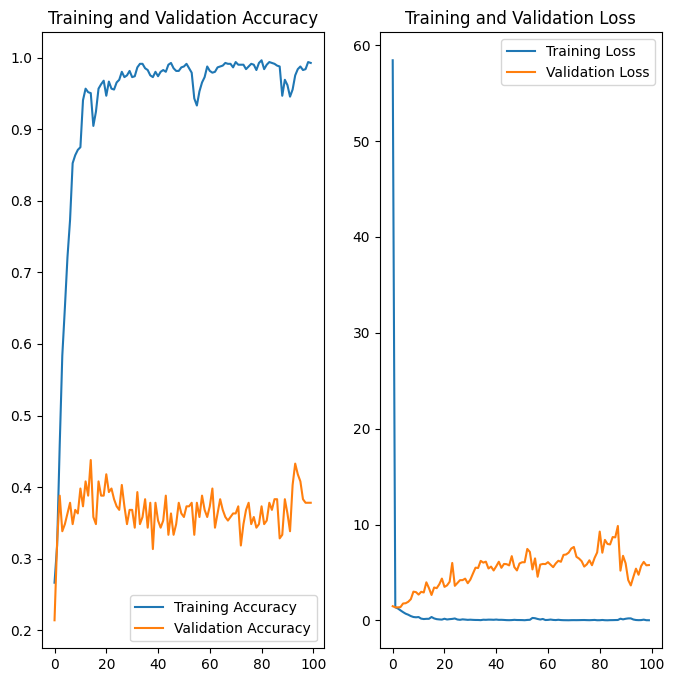

In [32]:
acc = history3.history['accuracy']
val_acc = history3.history['val_accuracy']

loss = history3.history['loss']
val_loss = history3.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In reviewing the validation metrics for my CNN model, it's clear there's a significant issue with generalization. The model registers a high validation loss of 5.7707 alongside a lower validation accuracy of 0.3781. When I compare these figures to those from my baseline multi-layer perceptron model, which achieved a validation loss of 1.8923 and a validation accuracy of 0.4030, the contrast is quite stark. The validation accuracy and loss for my CNN are worse, implying that, despite its sophisticated architecture, it is outperformed by the multi-layer perceptron in terms of generalizing to new data. This suggests that my CNN may be overfitting, having become too finely tuned to the training data and thus failing to predict unseen data effectively. 

Final validation accuracy: 0.3781

### Question 1.4 Transfer learning (35 points)

In this question, we will use the several well-known architectures that has been trained on ImageNet which is a very large database of images of different categories. In a nutshell, these architectures have already learnt kernels which are supposed to be good not only for the task it has been train on but maybe for other tasks.

The idea is that first layers are not specialized for the particular task it has been trained on; only the last ones are. Therefore, we will load the existing network, remove the last fully connected layers, replace them by new connected layers (whose weights are randomly set), and train these last layers on a specific classification task - here, separate types of flower. The underlying idea is that the first convolutional layers of model, that has already been trained, corresponds to filters that are able to extract meaning features from images. And you will only learn the last layers for your particular problem.

❓ **Question** ❓ Write a first function `load_model()` that loads the pretrained models from `tensorflow.keras.applications`. Especially, look at the [documentation](https://www.tensorflow.org/api_docs/python/tf/keras/applications) to load the model where:
- the `weights` have been learnt on `imagenet`
- the `input_shape` corresponds to the input shape of any of your images - you have to resize them in case they are not of the same size
- the `include_top` argument is set to `False` in order not to load the fully-connected layers of the VGG-16 without the last layer which was specifically trained on `imagenet`

Write a function that takes the previous model as input the set the girst layers to be non-trainable, by applying `model.trainable = False`. Then check-out the summary of the model to see that now, the parameters are `non-trainable`. Then write a function that adds flattening and dense layers after the first convolutional layers. You can define each layer (or group of layers) separately and concatenate them using the classic `layers.Sequential()` like below:

```
model = tf.keras.Sequential([
  base_model,
  flattening_layer,
  dense_layer,
  prediction_layer
])
```

Replicate the above steps by adding a flattening and two dense layers (the first with 500 neurons) to the previous model.

Estimate the model and report the accuracy and loss achieved. Explain whether model would benefit from transfer lerarning in comparison to the previous model architectures.

Try to use the following models: VGG16, Inception, ResNet, MobileNet and EfficientNet and compare their performance and running time. Explain which model would work the best.

In [33]:
def load_model(model_name, input_shape):
  """
  Load a pre-trained model from TensorFlow Keras applications with specific configurations.

  Arguments
  ---------
  model_name (str):
    The model name to load.
  input_shape (tuple):
    Desired input shape for the model.

  Returns
  ---------
  tf.keras.Model:
    The loaded Keras model with ImageNet weights.
  """
  if model_name == "VGG16":
    model = keras.applications.VGG16(input_shape=input_shape,
                                               include_top=False,
                                               weights='imagenet')
  elif model_name == "InceptionV3":
    model = keras.applications.InceptionV3(input_shape=input_shape,
                                               include_top=False,
                                               weights='imagenet')
  elif model_name == "ResNet50":
    model = keras.applications.ResNet50(input_shape=input_shape,
                                               include_top=False,
                                               weights='imagenet')
  elif model_name == "MobileNetV2":
    model = keras.applications.MobileNetV2(input_shape=input_shape,
                                               include_top=False,
                                               weights='imagenet')
  elif model_name == "EfficientNetB0":
    model = keras.applications.EfficientNetB0(input_shape=input_shape,
                                               include_top=False,
                                               weights='imagenet')
  else:
      raise ValueError(f"Unsupported model name {model_name}. Choose from 'VGG16', 'InceptionV3', 'ResNet50', 'MobileNetV2', 'EfficientNetB0'.")

  return model


def freeze(model):
  """
  Set the first layers of the given model to non-trainable.

  Arguments
  ---------
  model (tf.keras.Model):
    The model whose layers will be set to non-trainable.

  Returns
  ---------
  None:
    The function modifies the model in place.
  """
  model.trainable = False

  #return model

model_vgg16 = load_model(model_name = "VGG16", input_shape = [img_height, img_width, 3])
freeze(model_vgg16)

model_vgg16.summary()


58889256/58889256 [==============================] - 2s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 256, 256, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 256, 256, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 128, 128, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 128, 128, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 128, 128, 128)     147584    
                                                              

All the parameters are non-trainable!

In [34]:
def extend_model_with_dense_layers(base_model, num_classes, num_dense_layers = 1, neurons_dense = 500, act_func = "relu"):
  """
  Extends a given base model with additional dense layers and a prediction layer.

  Parameters:
  -----------
  base_model : tf.keras.Model
      The pre-trained model to extend.
  num_classes : int
      The number of classes for the final prediction layer.
  num_dense_layers : int, optional
      The number of dense layers to add (default is 1).
  neurons_dense : int, optional
      The number of neurons in each dense layer (default is 500).
  act_func : str, optional
      The activation function to use in the dense layers (default is "relu").

  Returns:
  --------
  tf.keras.Model
      The extended model with the specified layers added.
  """
  model = tf.keras.Sequential([
      # Base model
      base_model,

      # Flatten layer
      tf.keras.layers.Flatten(),

      # Dense layers
      *[layer for i in range(num_dense_layers) for layer in (
        keras.layers.Dense(neurons_dense, activation=act_func),
      )],

      # Prediction layer
      tf.keras.layers.Dense(num_classes, activation='softmax')
  ])

  return model

model_vgg16 = extend_model_with_dense_layers(base_model = model_vgg16, num_classes = num_classes, num_dense_layers = 1)
model_vgg16.summary()

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 8, 8, 512)         14714688  
                                                                 
 flatten_13 (Flatten)        (None, 32768)             0         
                                                                 
 dense_254 (Dense)           (None, 500)               16384500  
                                                                 
 dense_255 (Dense)           (None, 4)                 2004      
                                                                 
Total params: 31101192 (118.64 MB)
Trainable params: 16386504 (62.51 MB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________


Epoch 1/100
26/26 [==============================] - 18s 397ms/step - loss: 23.8290 - accuracy: 0.7571 - val_loss: 3.4267 - val_accuracy: 0.8308
Epoch 2/100
26/26 [==============================] - 5s 191ms/step - loss: 0.7237 - accuracy: 0.9480 - val_loss: 4.3471 - val_accuracy: 0.8458
Epoch 3/100
26/26 [==============================] - 5s 193ms/step - loss: 0.1471 - accuracy: 0.9827 - val_loss: 5.7219 - val_accuracy: 0.8308
Epoch 4/100
26/26 [==============================] - 5s 194ms/step - loss: 0.0320 - accuracy: 0.9938 - val_loss: 7.1141 - val_accuracy: 0.8159
Epoch 5/100
26/26 [==============================] - 5s 196ms/step - loss: 0.0203 - accuracy: 0.9938 - val_loss: 4.5783 - val_accuracy: 0.8308
Epoch 6/100
26/26 [==============================] - 5s 197ms/step - loss: 0.0074 - accuracy: 0.9975 - val_loss: 6.1352 - val_accuracy: 0.8358
Epoch 7/100
26/26 [==============================] - 5s 199ms/step - loss: 0.0023 - accuracy: 0.9988 - val_loss: 5.5564 - val_accuracy: 0.84

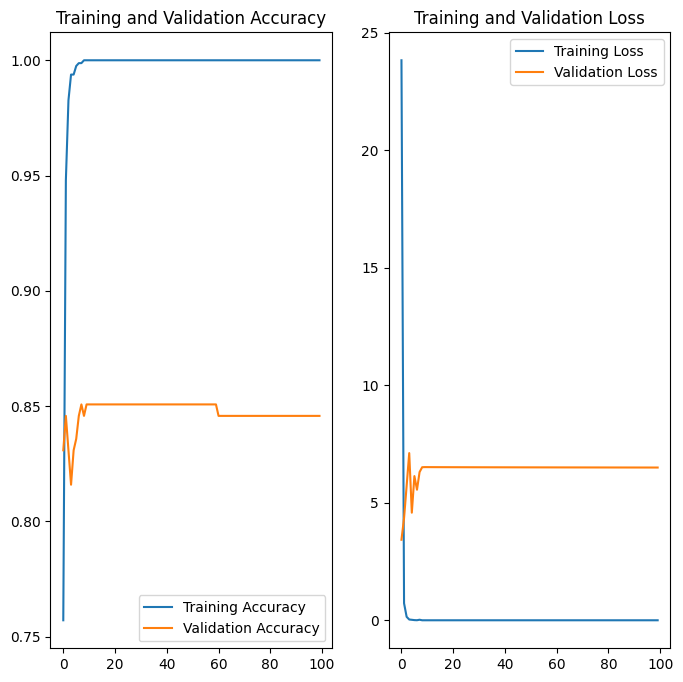

In [ ]:
# Compile the model
model_vgg16.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
model_vgg16 = model_vgg16.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(model_vgg16)

The VGG16 model, as depicted in the image, showcases perfect training accuracy and a very high validation accuracy, suggesting it outperforms the other models on the dataset. The baseline MLP, even after adjustments, and the CNN have lower validation accuracies, indicating that they don't generalize as well to new data. In terms of performance, the VGG16 model is the best model until now, striking a better balance between learning from the training data and generalizing to new, unseen data.

Final validation accuracy: 0.8458

87910968/87910968 [==============================] - 3s 0us/step
Epoch 1/100
26/26 [==============================] - 16s 322ms/step - loss: 335.3194 - accuracy: 0.3693 - val_loss: 89.7347 - val_accuracy: 0.3881
Epoch 2/100
26/26 [==============================] - 3s 119ms/step - loss: 39.9905 - accuracy: 0.5923 - val_loss: 48.6571 - val_accuracy: 0.4726
Epoch 3/100
26/26 [==============================] - 3s 120ms/step - loss: 12.5462 - accuracy: 0.7720 - val_loss: 43.1870 - val_accuracy: 0.4627
Epoch 4/100
26/26 [==============================] - 3s 118ms/step - loss: 4.9788 - accuracy: 0.8612 - val_loss: 39.1616 - val_accuracy: 0.5174
Epoch 5/100
26/26 [==============================] - 3s 117ms/step - loss: 3.5647 - accuracy: 0.9021 - val_loss: 39.9871 - val_accuracy: 0.4925
Epoch 6/100
26/26 [==============================] - 3s 117ms/step - loss: 3.1127 - accuracy: 0.9232 - val_loss: 44.5261 - val_accuracy: 0.4975
Epoch 7/100
26/26 [==============================] - 3s 120ms/step

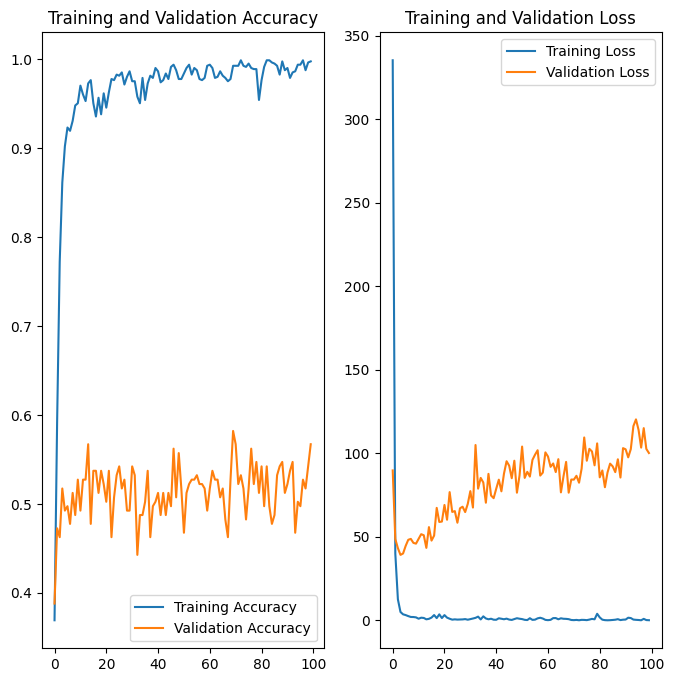

In [ ]:
# Set up InceptionV3
model_InceptionV3 = load_model(model_name = "InceptionV3", input_shape = [img_height, img_width, 3])
freeze(model_InceptionV3)
model_InceptionV3 = extend_model_with_dense_layers(base_model = model_InceptionV3, num_classes = num_classes, num_dense_layers = 1)

# Compile the model
model_InceptionV3.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
model_InceptionV3 = model_InceptionV3.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(model_InceptionV3)

The InceptionV3 model shows an excellent training accuracy, but the extremely high validation loss is indicating that the model is overfitting significantly to the training data. The huge gap between training and validation loss underscores that the model's predictions on new data are very unreliable.

Taking both accuracy and loss into account, VGG16 stands out as the best-performing model until now, delivering high reliability in unseen data predictions. InceptionV3doesn't translate that learning effectively to new data due to the overfitting issue as evidenced by its validation loss.

Final validation accuracy: 0.5672

Epoch 1/100
26/26 [==============================] - 43s 505ms/step - loss: 17.6515 - accuracy: 0.7534 - val_loss: 2.3988 - val_accuracy: 0.8756
Epoch 2/100
26/26 [==============================] - 4s 148ms/step - loss: 0.4872 - accuracy: 0.9641 - val_loss: 1.5214 - val_accuracy: 0.8706
Epoch 3/100
26/26 [==============================] - 4s 149ms/step - loss: 0.0724 - accuracy: 0.9901 - val_loss: 1.4641 - val_accuracy: 0.9055
Epoch 4/100
26/26 [==============================] - 4s 149ms/step - loss: 0.0381 - accuracy: 0.9938 - val_loss: 1.7208 - val_accuracy: 0.8905
Epoch 5/100
26/26 [==============================] - 4s 150ms/step - loss: 0.0063 - accuracy: 0.9975 - val_loss: 1.6228 - val_accuracy: 0.8856
Epoch 6/100
26/26 [==============================] - 4s 150ms/step - loss: 0.0054 - accuracy: 0.9975 - val_loss: 1.7168 - val_accuracy: 0.8856
Epoch 7/100
26/26 [==============================] - 4s 150ms/step - loss: 0.0124 - accuracy: 0.9988 - val_loss: 2.0408 - val_accuracy: 0.89

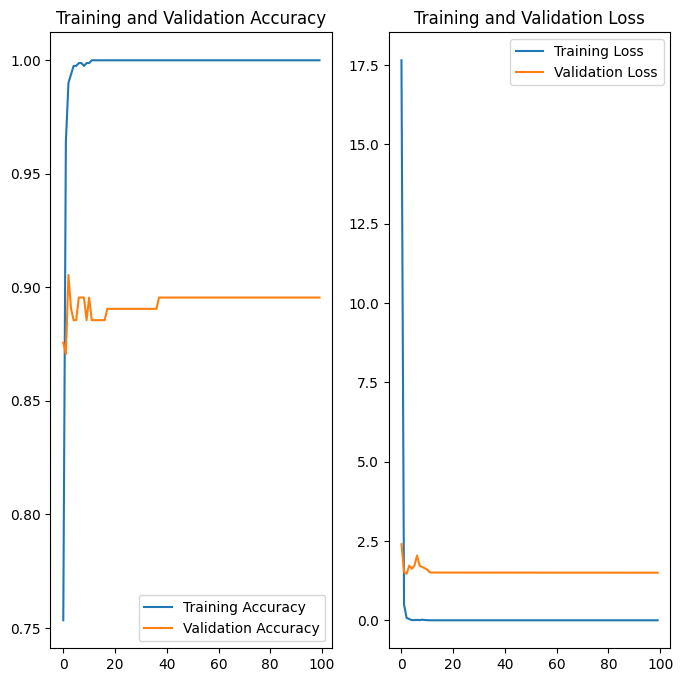

In [ ]:
# Set up ResNet50
model_ResNet50 = load_model(model_name = "ResNet50", input_shape = [img_height, img_width, 3])
freeze(model_ResNet50)
model_ResNet50 = extend_model_with_dense_layers(base_model = model_ResNet50, num_classes = num_classes, num_dense_layers = 1)

# Compile the model
model_ResNet50.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
model_ResNet50 = model_ResNet50.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(model_ResNet50)

The ResNet50 model has achieved perfect training accuracy and an impressive validation accuracy. Unlike InceptionV3, ResNet50 maintains a low validation loss, which indicates a strong ability to generalize well to new data without significant overfitting.

When set against the VGG16, the ResNet50 has a slightly higher validation accuracy and a much lower validation loss, suggesting it is the better-performing model in terms of balancing training performance with generalization to validation data.

Therefore, considering both the low validation loss and the high validation accuracy, ResNet50 is the best-performing model so far.

Final validation accuracy: 0.8955

9406464/9406464 [==============================] - 1s 0us/step
Epoch 1/100
26/26 [==============================] - 8s 160ms/step - loss: 12.7781 - accuracy: 0.5217 - val_loss: 2.1103 - val_accuracy: 0.7114
Epoch 2/100
26/26 [==============================] - 2s 73ms/step - loss: 0.9330 - accuracy: 0.8513 - val_loss: 2.9161 - val_accuracy: 0.6766
Epoch 3/100
26/26 [==============================] - 2s 73ms/step - loss: 0.1011 - accuracy: 0.9641 - val_loss: 2.3756 - val_accuracy: 0.7164
Epoch 4/100
26/26 [==============================] - 2s 73ms/step - loss: 0.0307 - accuracy: 0.9876 - val_loss: 1.8816 - val_accuracy: 0.7413
Epoch 5/100
26/26 [==============================] - 2s 73ms/step - loss: 0.0050 - accuracy: 0.9988 - val_loss: 2.1129 - val_accuracy: 0.7065
Epoch 6/100
26/26 [==============================] - 2s 74ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 1.9841 - val_accuracy: 0.7413
Epoch 7/100
26/26 [==============================] - 2s 74ms/step - loss: 6.6486e-0

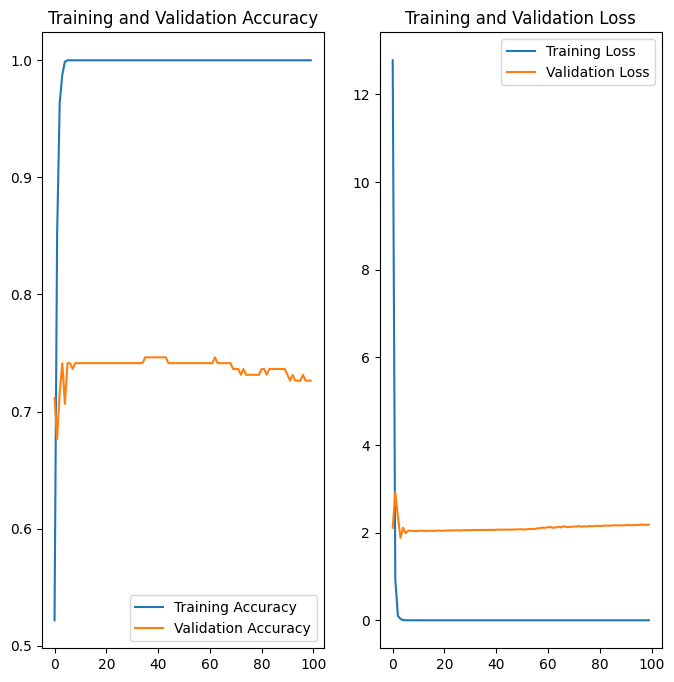

In [ ]:
# Set up MobileNetV2
model_MobileNetV2 = load_model(model_name = "MobileNetV2", input_shape = [img_height, img_width, 3])
freeze(model_MobileNetV2)
model_MobileNetV2 = extend_model_with_dense_layers(base_model = model_MobileNetV2, num_classes = num_classes, num_dense_layers = 1)

# Compile the model
model_MobileNetV2.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
model_MobileNetV2 = model_MobileNetV2.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(model_MobileNetV2)

The MobileNetV2 model also achieves perfect training accuracy, yet its validation accuracy is lower compared to the ResNet50 model. However, its validation loss is higher than that of ResNet50 but still significantly lower than InceptionV3's. This indicates that while MobileNetV2 has learned the training data effectively, it is not as proficient as ResNet50 in generalizing to unseen data, but it is much better at it than InceptionV3.

The MobileNetV2 demonstrates good performance but doesn't quite match the balance of high validation accuracy and low validation loss shown by the ResNet50 model. Therefore, ResNet50 remains the best performing model so far, with its superior ability to generalize well to new data.

Final validation accuracy for MobileNetV2: 0.7264

16705208/16705208 [==============================] - 1s 0us/step
Epoch 1/100
26/26 [==============================] - 13s 236ms/step - loss: 1.4787 - accuracy: 0.8674 - val_loss: 0.7638 - val_accuracy: 0.9005
Epoch 2/100
26/26 [==============================] - 3s 105ms/step - loss: 0.1284 - accuracy: 0.9740 - val_loss: 0.8366 - val_accuracy: 0.9055
Epoch 3/100
26/26 [==============================] - 3s 106ms/step - loss: 0.0271 - accuracy: 0.9938 - val_loss: 0.9437 - val_accuracy: 0.9303
Epoch 4/100
26/26 [==============================] - 3s 106ms/step - loss: 0.0607 - accuracy: 0.9876 - val_loss: 1.1853 - val_accuracy: 0.9005
Epoch 5/100
26/26 [==============================] - 3s 106ms/step - loss: 0.0477 - accuracy: 0.9926 - val_loss: 0.9215 - val_accuracy: 0.9254
Epoch 6/100
26/26 [==============================] - 3s 106ms/step - loss: 0.0451 - accuracy: 0.9938 - val_loss: 0.8101 - val_accuracy: 0.9403
Epoch 7/100
26/26 [==============================] - 3s 109ms/step - loss: 0

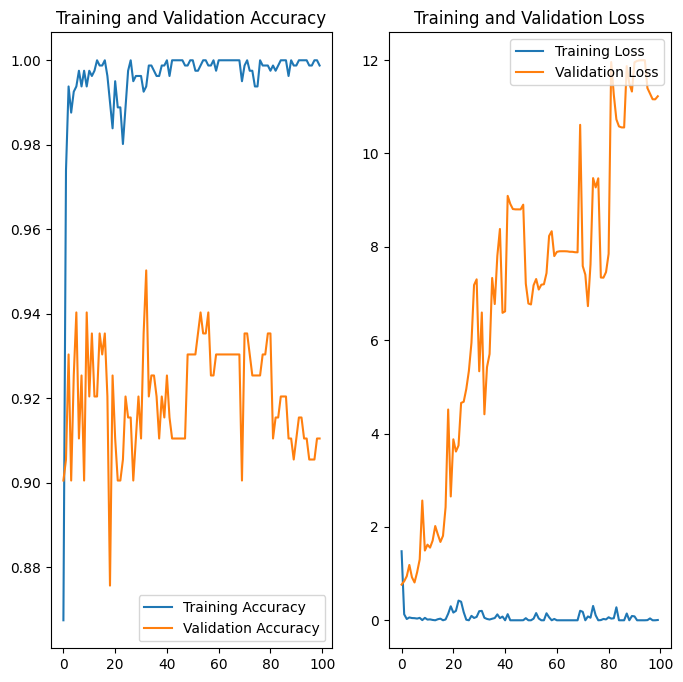

In [ ]:
# Set up EfficientNetB0
model_EfficientNetB0 = load_model(model_name = "EfficientNetB0", input_shape = [img_height, img_width, 3])
freeze(model_EfficientNetB0)
model_EfficientNetB0 = extend_model_with_dense_layers(base_model = model_EfficientNetB0, num_classes = num_classes, num_dense_layers = 1)

# Compile the model
model_EfficientNetB0.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])

# Training
epochs=100
model_EfficientNetB0 = model_EfficientNetB0.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

# Plotting the results
performance_plot(model_EfficientNetB0)

The EfficientNetB0 model presents a very high training accuracy and the highest validation accuracy among the models we've discussed, yet it suffers from a high validation loss. This elevated validation loss, much like with the InceptionV3 model, suggests that while the model is almost perfect at learning the training set, it struggles with generalization, leading to less reliable predictions on the validation set.

Although the validation accuracy is higher than that of ResNet50, the excessive validation loss of EfficientNetB0 compared to ResNet50's reasonable loss highlights a significant overfitting issue in EfficientNetB0. ResNet50 maintains the lead as the best-performing model given its excellent balance of high accuracy and low loss on unseen data.

Final validation accuracy for EfficientNetB0: 0.9104

### Conclusion

Overall, the transfer learning models (VGG16, ResNet50, MobileNetV2, InceptionV3, EfficientNetB0) significantly outperform the MLP and adjusted MLP models, which suffer from either high validation loss or low validation accuracy, likely due to the complexity and depth of their architecture. Among the transfer learning approaches, ResNet50 stands out as the best model, achieving an ideal balance of high validation accuracy and low validation loss, indicating strong generalization capabilities. The CNN also falls short compared to the transfer learning models, due to overfitting as evidenced by its high validation loss. The deep architectures of the MLPs with 20 dense layers are likely not suitable for the task at hand, leading to their poorer performance. In conclusion, the ResNet50 model, with its robust transfer learning application, is the top performer in this comparison.